In [153]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import itertools
import datetime as dt
from statsmodels.tsa.stattools import grangercausalitytests
import statsmodels.api as sm

In [17]:
price_df = pd.read_csv('Price_data.csv')

### Granger Causality tests

#### Casuality using prices

In [83]:
lag_range = range(-50, 50)
max_lag = 20
significant_results = {}
# for (stock1, stock2) in list(itertools.combinations(range(0,2),2)):
for stock1 in range(0,50):
    for stock2 in range(0,50):
        if stock1 != stock2:
            return_1 = price_df.loc[price_df['STOCK'] == stock1, "PRICE"].reset_index(drop=True)
            return_2 = price_df.loc[price_df['STOCK'] == stock2, "PRICE"].reset_index(drop=True)
            new_df = pd.DataFrame({'A': return_1, 'B': return_2})
            test_result = grangercausalitytests(new_df, maxlag=max_lag)
            for lag in range(1, max_lag+1):
                p_value = test_result[lag][0]['ssr_ftest'][1]
                if p_value < 0.05:
                    key = f'Stock{stock2} causes Stock{stock1} at lag {lag}'
                    significant_results[key] = p_value

# Display the significant results
for key, value in significant_results.items():
    print(f'{key}: p-value = {value}')
    
    # cross_corr = [return_1.corr(return_2.shift(lag)) for lag in lag_range]
    # if any(not np.isnan(corr) for corr in cross_corr):
    #     correlated_pairs.append((stock1, stock2))
    # plt.plot(lag_range, cross_corr)
    # print(cross_corr)
    # plt.xlabel('Lag')
    # plt.ylabel('Cross-correlation')
    # plt.title(f'Cross-correlation between Stock{stock1} and Stock{stock2}')
    # plt.xlim((-20, 20))
    # plt.show()
        


Granger Causality
number of lags (no zero) 1
ssr based F test:         F=7.6739  , p=0.0058  , df_denom=496, df_num=1
ssr based chi2 test:   chi2=7.7203  , p=0.0055  , df=1
likelihood ratio test: chi2=7.6612  , p=0.0056  , df=1
parameter F test:         F=7.6739  , p=0.0058  , df_denom=496, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=4.0758  , p=0.0176  , df_denom=493, df_num=2
ssr based chi2 test:   chi2=8.2343  , p=0.0163  , df=2
likelihood ratio test: chi2=8.1670  , p=0.0168  , df=2
parameter F test:         F=4.0758  , p=0.0176  , df_denom=493, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=3.1278  , p=0.0255  , df_denom=490, df_num=3
ssr based chi2 test:   chi2=9.5175  , p=0.0231  , df=3
likelihood ratio test: chi2=9.4275  , p=0.0241  , df=3
parameter F test:         F=3.1278  , p=0.0255  , df_denom=490, df_num=3

Granger Causality
number of lags (no zero) 4
ssr based F test:         F=2.2331  , p=0.0644  

In [90]:
def save_dict_to_file(d, filename):
    with open(filename, 'w') as file:
        for key, value in significant_results.items():
            file.write(f'{key}: p-value = {value} \n')

# Save the example dictionary to a text file
save_dict_to_file(significant_results, 'price_causality_results.txt')


#### Causality using log returns

In [139]:
max_lag = 5
significant_results_return = {}
significant_pairs = {}
# for (stock1, stock2) in list(itertools.combinations(range(0,2),2)):
for stock1 in range(0,50):
    for stock2 in range(0,50):
        if stock1 != stock2:
            return_1 = price_df.loc[price_df['STOCK'] == stock1, "LOG_RETURN"].reset_index(drop=True).dropna()
            return_2 = price_df.loc[price_df['STOCK'] == stock2, "LOG_RETURN"].reset_index(drop=True).dropna()
            new_df = pd.DataFrame({'A': return_1, 'B': return_2})
            test_result = grangercausalitytests(new_df, maxlag=max_lag)
            for lag in range(1, max_lag+1):
                p_value = test_result[lag][0]['ssr_ftest'][1]
                if p_value < 0.01:
                    key = f'Stock{stock2} causes Stock{stock1} at lag {lag}'
                    significant_results_return[key] = p_value
                    if stock2 in significant_pairs.keys():
                        significant_pairs[stock2].add(stock1)
                    else:
                        significant_pairs[stock2] = {stock1}

# Display the significant results
# for key, value in significant_results.items():
#     print(f'{key}: p-value = {value}')


Granger Causality
number of lags (no zero) 1
ssr based F test:         F=0.0019  , p=0.9653  , df_denom=495, df_num=1
ssr based chi2 test:   chi2=0.0019  , p=0.9652  , df=1
likelihood ratio test: chi2=0.0019  , p=0.9652  , df=1
parameter F test:         F=0.0019  , p=0.9653  , df_denom=495, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=0.0612  , p=0.9406  , df_denom=492, df_num=2
ssr based chi2 test:   chi2=0.1237  , p=0.9400  , df=2
likelihood ratio test: chi2=0.1236  , p=0.9400  , df=2
parameter F test:         F=0.0612  , p=0.9406  , df_denom=492, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=0.2171  , p=0.8846  , df_denom=489, df_num=3
ssr based chi2 test:   chi2=0.6606  , p=0.8824  , df=3
likelihood ratio test: chi2=0.6601  , p=0.8825  , df=3
parameter F test:         F=0.2171  , p=0.8846  , df_denom=489, df_num=3

Granger Causality
number of lags (no zero) 4
ssr based F test:         F=0.3664  , p=0.8326  

In [140]:

save_dict_to_file(significant_results_return, 'return_causality_results_lag5.txt')


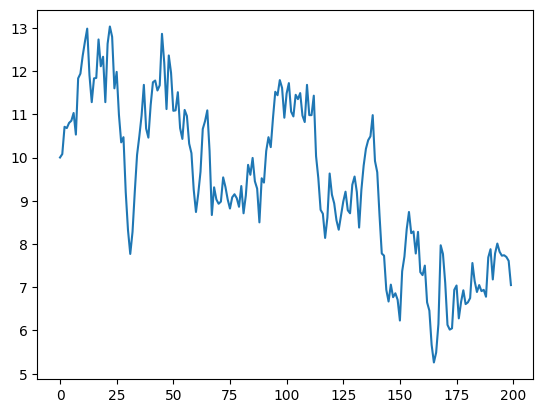

In [207]:
return_1 = price_df.loc[price_df['STOCK'] == 46, "PRICE"].iloc[0:200].reset_index(drop=True)
return_2 = price_df.loc[price_df['STOCK'] == 25, "PRICE"].shift(20).iloc[20:220].reset_index(drop=True)    
plt.plot(range(len(return_1)), return_1-return_2)
# plt.plot(range(len(return_1)), return_1)
# plt.plot(range(len(return_2)), return_2)
plt.show()
# cross_corr = [return_1.corr(return_2.shift(lag)) for lag in lag_range]
# plt.plot(lag_range, cross_corr)
# print(cross_corr)
# plt.xlabel('Lag')
# plt.ylabel('Cross-correlation')
# plt.title(f'Cross-correlation between Stock{stock1} and Stock{stock2}')
# plt.xlim((-20, 20))
# plt.show()

### Correlation tests

/var/folders/wg/4hlcszls02vfyr1nhwtnm3q40000gn/T/ipykernel_7775/206713536.py:7: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  cross_corr_negative = [np.corrcoef(return_1, return_2.shift(lag).fillna(method="ffill"))[0,1] for lag in negative_lag]
/var/folders/wg/4hlcszls02vfyr1nhwtnm3q40000gn/T/ipykernel_7775/206713536.py:8: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  cross_corr_positive = [np.corrcoef(return_1, return_2.shift(lag).fillna(method="bfill"))[0,1] for lag in positive_lag]


[0.9368894321647376, 0.9374778286341672, 0.9385704109256143, 0.9393717879179235, 0.9398733468734533, 0.9395134090498896, 0.9388758534150862, 0.9381398687145693, 0.9372789082890395, 0.9359954041973557, 0.9346749693619, 0.9328219493670327, 0.9314691541694426, 0.9297432100004854, 0.9274770949193365, 0.9253020642223097, 0.9235587304798363, 0.9228059412532448, 0.9215909912593545, 0.920296747828411, 0.9193219817506404, 0.9180399378074797, 0.9168793918723974, 0.9155480204135965, 0.914225792017424, 0.9128754520842184, 0.9109107339530608, 0.9085403979934389, 0.9053790901077076, 0.9022700693334756, 0.8991245029591062, 0.8964942241316445, 0.893882612973976, 0.8911958818723914, 0.8882040814596806, 0.885343810142488, 0.8823112326905929, 0.8786329031529388, 0.8747478119003315, 0.8707374274726359, 0.865905567931019]


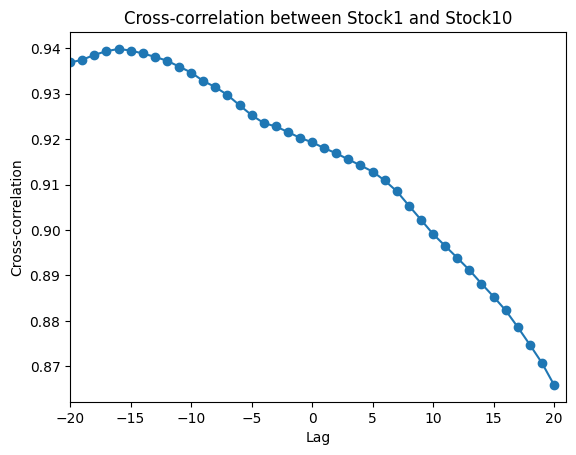

[0.8991157889189847, 0.9011697805559644, 0.9032292549088026, 0.905516728563533, 0.9074746738009122, 0.909595387222022, 0.9116679966531531, 0.9136387085379741, 0.9151131665477602, 0.9166165777055618, 0.9180055530200952, 0.919369865810383, 0.9207425057041658, 0.9220697392844249, 0.9237462332866846, 0.9251412604255081, 0.926428254943566, 0.9272984419844493, 0.9284557855680959, 0.9292995317106653, 0.9302617222989314, 0.9304803461955709, 0.9300947754938234, 0.9291448185424145, 0.9282311553510989, 0.9276459100962838, 0.9268349988553279, 0.9263484564713654, 0.9255994258882139, 0.9246840744024555, 0.9238492884834595, 0.9230984677222205, 0.9218400313074075, 0.9206798546151853, 0.9201298200399588, 0.9192416130892369, 0.9181772765717895, 0.916812386723676, 0.9154743934348138, 0.9138859282145448, 0.9118518945197701]


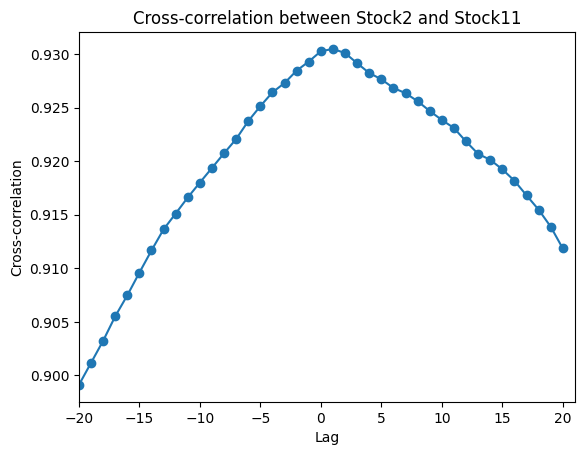

[0.9206676743880516, 0.9212689808792204, 0.9218445832873333, 0.9224521569805036, 0.9226042863574933, 0.9228272184744573, 0.9231765648225932, 0.9235080294361676, 0.9238703661185194, 0.9244917083472746, 0.9250751977043334, 0.9255855871209399, 0.9260712191071457, 0.926945024729782, 0.9278681885097688, 0.9286471488184816, 0.9295884268160551, 0.9302909807816239, 0.9310729801268094, 0.9316435115967642, 0.9317311470451727, 0.9310886784093313, 0.9296487449579682, 0.9278082857458569, 0.9260227479063312, 0.9241074362899859, 0.9224332305434618, 0.9210143788272288, 0.9193731278749476, 0.9172127206643067, 0.9149979141912465, 0.9132656699990749, 0.9116549416354606, 0.9098344952838819, 0.9079910103182166, 0.9061769344356656, 0.9041611962501268, 0.9018132586010287, 0.8993356563845601, 0.8968777198653546, 0.8945347433736627]


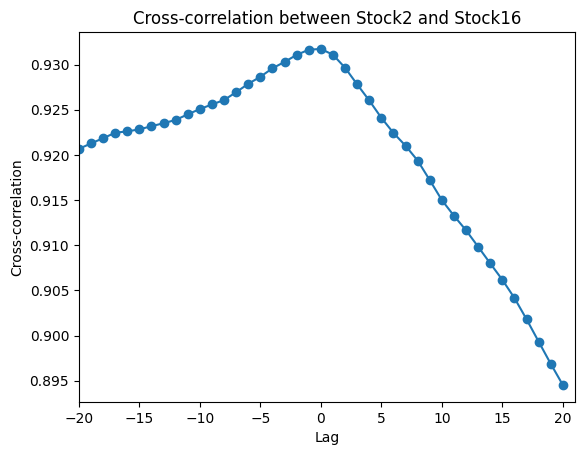

[0.8998344998687636, 0.9011899704141272, 0.902489731045686, 0.9037800244102383, 0.9050674466458165, 0.906309643412019, 0.9076085021406742, 0.908932264554956, 0.9102164242262897, 0.9116987213032197, 0.9132271648988458, 0.9148783160944771, 0.9165738139766227, 0.9182890585177781, 0.9199771576710709, 0.9216277505013516, 0.9232317408429739, 0.9247608386867623, 0.9263312351173494, 0.9277727284513984, 0.9290809736987535, 0.9300175592263553, 0.9305696248568259, 0.9312157970923833, 0.9318828309395732, 0.9325817875415338, 0.933353146319637, 0.9341997550025588, 0.9351071350077294, 0.9359352481562732, 0.9366615331079834, 0.9373899970316938, 0.9382102613948818, 0.9390051627264641, 0.9398761838571614, 0.9407529545290774, 0.9416634348518087, 0.942449631864125, 0.9431497449803746, 0.9437338389871895, 0.9442154090626315]


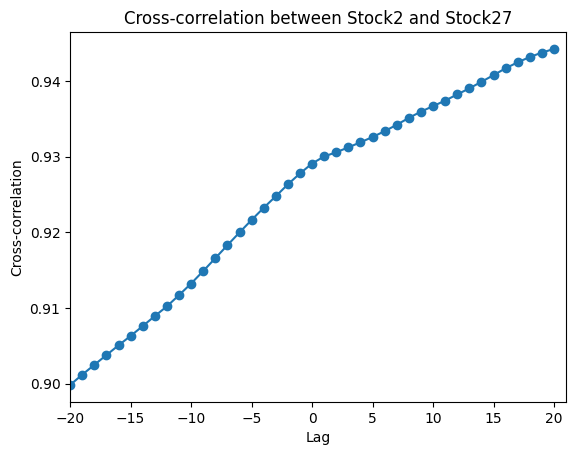

[0.9708860841040172, 0.9705822859123219, 0.970196179282651, 0.9697392651895157, 0.969073716333232, 0.9681855809672562, 0.9673585423196267, 0.9665663137460418, 0.9657009669218024, 0.9648667659438095, 0.9641196880738395, 0.9632382761508441, 0.9624168061527466, 0.9616727475920787, 0.9608942847809967, 0.9601525072378819, 0.9591703681744053, 0.9580651914379734, 0.9569956785983788, 0.9557984139402046, 0.9545376047968862, 0.953047647407054, 0.951308123583555, 0.9495925388266239, 0.9478304561449055, 0.9460857962752959, 0.9443573308363293, 0.9425018158782729, 0.9404823486405791, 0.9385322581082877, 0.9365150643652165, 0.9345439212200696, 0.9324241609116689, 0.9302696733664557, 0.9281208893077671, 0.9259840749340397, 0.923688151553538, 0.9213569654016364, 0.9191294325486734, 0.9169364064959905, 0.9145876125758092]


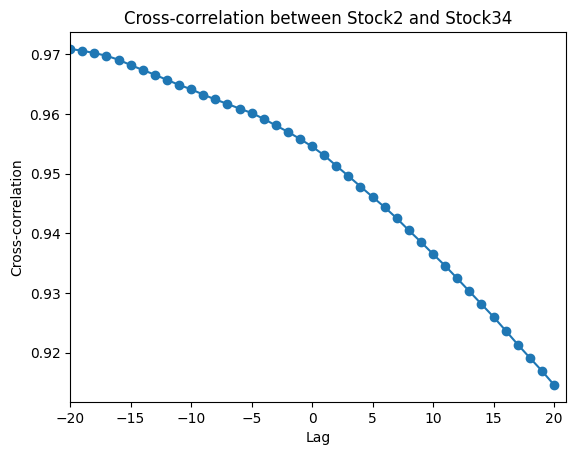

[0.9316735389531234, 0.932685191858043, 0.9337120757986214, 0.9347988564298861, 0.9359014841228288, 0.9373913492043973, 0.9391441628303467, 0.9409310235006996, 0.9425462272721832, 0.9440123101010481, 0.9453271151810501, 0.9461334020163865, 0.9468849293359883, 0.9475527547888863, 0.9480631206610299, 0.9482382647327583, 0.9481099585733889, 0.9479457880348756, 0.9475968011470928, 0.9472693480664897, 0.9467705974033191, 0.9462535010555659, 0.9457807884622299, 0.9453338915681084, 0.9453015166418798, 0.9454629830684755, 0.9457735674703394, 0.9459323387311893, 0.9459017263277553, 0.9460224355748396, 0.946276209289439, 0.9467482696644767, 0.9471102320032639, 0.9472280796531508, 0.9471163751056593, 0.9471404008826456, 0.9472994689326886, 0.9471604514266359, 0.9473956074507263, 0.9477657002008044, 0.9478413743146198]


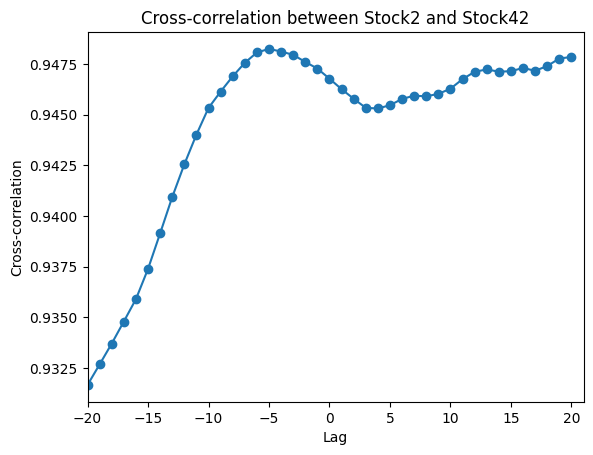

[0.9259930867458196, 0.9264233737453733, 0.9269848618449895, 0.9274635620092988, 0.927743684323514, 0.927785003093361, 0.9277768806776595, 0.928086955930995, 0.9281817463239557, 0.928070280293063, 0.9279814419879748, 0.9277778266812415, 0.9275821667365598, 0.9275604679154704, 0.9276166732661594, 0.9276277383767288, 0.9276590976775669, 0.9277481350170074, 0.9277800573412526, 0.9278770985383329, 0.9277481390362915, 0.9277843628586224, 0.9276685595908462, 0.9278063354731606, 0.927721088383379, 0.9276322546502715, 0.927330517553322, 0.9269518206946452, 0.9266805385601815, 0.9266993278489561, 0.9264495402857832, 0.9263621582576478, 0.9261387089035558, 0.9260675975447195, 0.9263121733826879, 0.9264543526174127, 0.9263705278561175, 0.926458275127758, 0.9265226118687792, 0.9263623137886801, 0.9260861267210214]


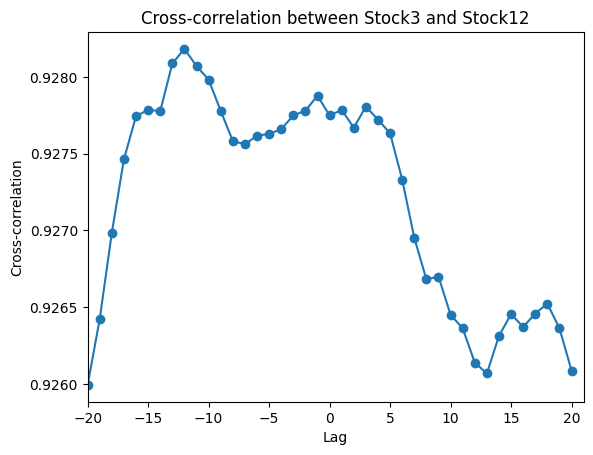

[0.922374198636348, 0.9218984825625992, 0.9214850832596181, 0.9210996454747852, 0.9205486626002535, 0.920078083648072, 0.9197020404652405, 0.9196405080236357, 0.9193288303756222, 0.9191657447762657, 0.9190756706970502, 0.9190420254069865, 0.9189825058837837, 0.9189131278350114, 0.9188494812639382, 0.9187869584758421, 0.918589283128589, 0.9183060095090808, 0.9178775662010212, 0.9173398619777852, 0.9166891332053608, 0.9160764166549896, 0.9153769104864042, 0.9144627724104089, 0.9134118370505805, 0.9126514988406862, 0.9118018027524639, 0.9111865150198395, 0.9105936899621107, 0.9099740205950994, 0.9095400937234613, 0.9089384172584604, 0.9085013954949726, 0.9078909039115672, 0.9072019128132622, 0.9064410883225723, 0.9057423149289987, 0.9050087461216654, 0.9042342397890859, 0.9035827870256445, 0.9027325935707079]


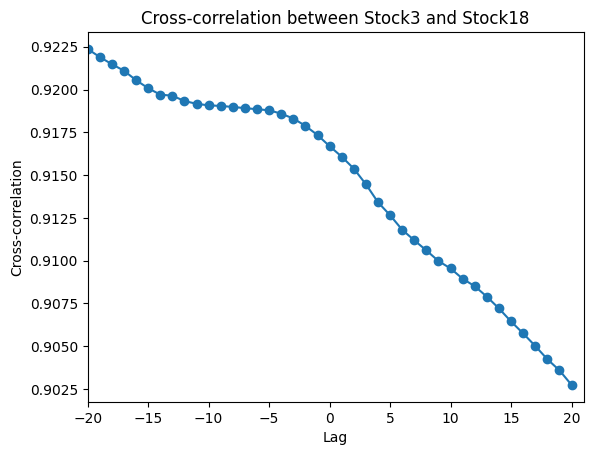

[0.9085436325573204, 0.9084875328605517, 0.9084386756378405, 0.9083300021058149, 0.9081312998949356, 0.9079865869776819, 0.9078331378869742, 0.9077936230966802, 0.9077131702556869, 0.9076232829498821, 0.9075835157929145, 0.907506279874595, 0.9073914239588828, 0.9073158756074164, 0.9072998087838183, 0.9073710151130253, 0.9073818784598038, 0.907403772249206, 0.9074256354344257, 0.9074226593490002, 0.9074760804781042, 0.9075824784686773, 0.9076399991292227, 0.9076955246666079, 0.9077630639614167, 0.9078538130951004, 0.9080469608101491, 0.908373879861934, 0.9088396089837187, 0.9092859682978324, 0.9097635677032637, 0.9101341373713836, 0.910552955955703, 0.9110590059416521, 0.9116834231543226, 0.9124842582957525, 0.9132543145324754, 0.9139207320349915, 0.9146021550019401, 0.9152491181955055, 0.9158188808695009]


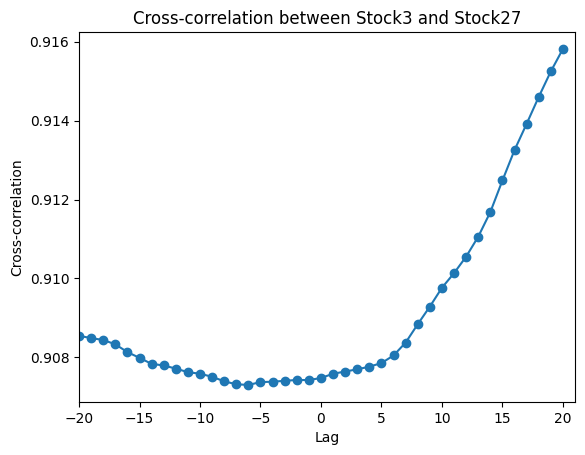

[0.9208727225065962, 0.9217083232841801, 0.9225548273445362, 0.923338198092762, 0.9241464781961246, 0.9247786089269763, 0.9253971952307951, 0.9258716903793253, 0.9263887266455225, 0.9270293434603432, 0.9277608357481749, 0.9284805712389972, 0.9291436180278401, 0.9299329607697608, 0.9307899931833139, 0.931758105385395, 0.9327256135961011, 0.9336328597391114, 0.9345946060537493, 0.9354411492107582, 0.9363083968701282, 0.9371568040006029, 0.9380869332194713, 0.9390003104835227, 0.9399234797199474, 0.9408227417109969, 0.9417682778957721, 0.9426344702444033, 0.9433569512664448, 0.9440867836208157, 0.9447792634736123, 0.945433505708514, 0.9460544235811472, 0.9466859350954812, 0.9473049538768012, 0.94785843721142, 0.948422333643779, 0.948967298239145, 0.9495841532390613, 0.9502362902410175, 0.9507580263533781]


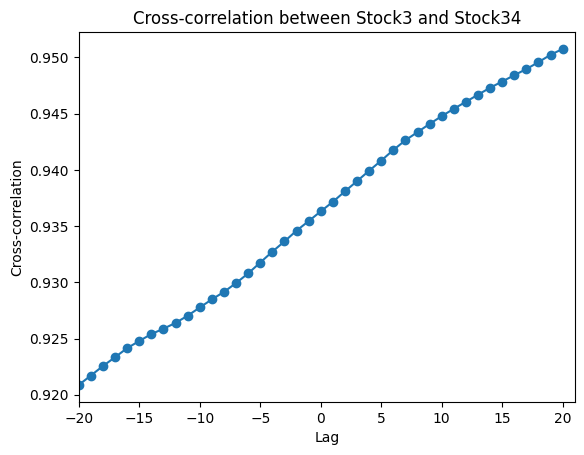

[0.9101256921310636, 0.9113953999244068, 0.9125853946412109, 0.9136591605440237, 0.9145032234761271, 0.9150835854950335, 0.9155114099254494, 0.9158600553485736, 0.916568113891309, 0.9174699801408517, 0.9184504115629765, 0.91942457619607, 0.9201670812095121, 0.9207833589595992, 0.9213169726644377, 0.9217310959156801, 0.9219929606440405, 0.9218415186869576, 0.921601686893537, 0.9212273184045247, 0.9207454013230901, 0.9198872527503908, 0.9191787774447137, 0.9185272023388025, 0.9176794334609427, 0.916577287747581, 0.9153299562922885, 0.9140755796125634, 0.9128241245215256, 0.9116011369216399, 0.9104613148633562, 0.909233795171756, 0.9081233316914554, 0.9069485931982083, 0.9057420834023479, 0.9046071055759708, 0.9035510286898668, 0.9026558117248819, 0.901708896759026, 0.9007693622918708, 0.8997387861872116]


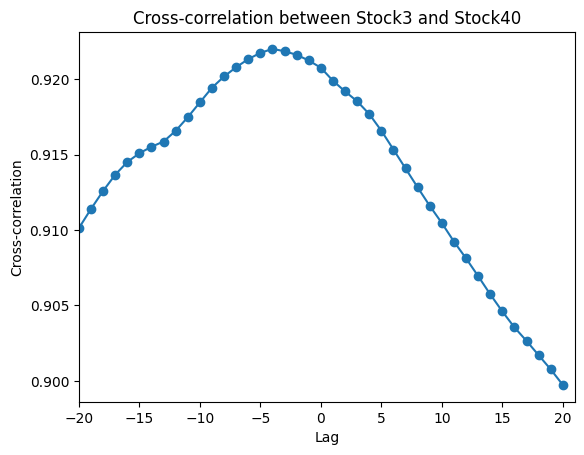

[0.8758784732239482, 0.877686510635257, 0.879479733498046, 0.8814070406308594, 0.8834669757177527, 0.8852205869347795, 0.8870631141059149, 0.8889644388779091, 0.8906589448333601, 0.8922965172442641, 0.8938340513003563, 0.8952412071734724, 0.8964594542735429, 0.8976041851935761, 0.8987112608544482, 0.8996857688996024, 0.9004752879911192, 0.9011350025878648, 0.9015852370511361, 0.9021877703782655, 0.9028540879210065, 0.9033984474734271, 0.9040220437399935, 0.9045831830804585, 0.9053427579605621, 0.9062015392201934, 0.906977821501223, 0.9076678772212258, 0.9084604299575691, 0.9092898405899361, 0.9102833728763136, 0.9111157802750769, 0.9118755802005415, 0.9125768776992548, 0.9131499269461872, 0.9135330425025764, 0.9143079281768112, 0.9151080110554851, 0.9158699571509649, 0.9167417088697307, 0.9177969419587461]


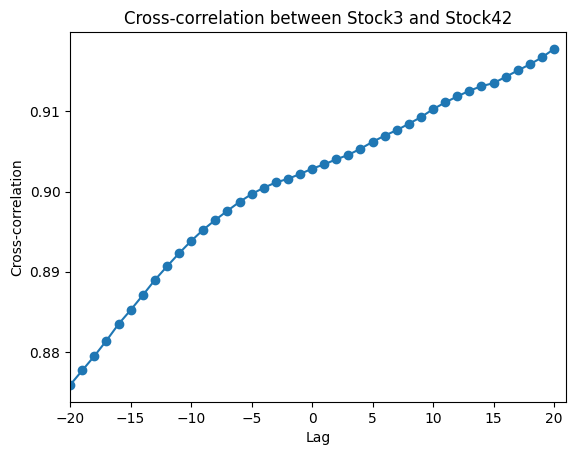

[0.8574387094431507, 0.8590086996115813, 0.8608358431275369, 0.8624410201041389, 0.8634928516692734, 0.8644311409976212, 0.8650917060075366, 0.8661908519922744, 0.8682868481059354, 0.8711218342875446, 0.8735855013954303, 0.8764437523030425, 0.8795733446015436, 0.8824745488556678, 0.8856814600342796, 0.8888889826326378, 0.8922909252545288, 0.8957879271834898, 0.8996184323555976, 0.902078360128402, 0.9020256523242633, 0.9014395313747158, 0.9005041762770309, 0.8992822625009111, 0.8974733591121484, 0.8950719945208128, 0.8934381458241036, 0.8918197469133993, 0.8896114734261608, 0.887426983825601, 0.8860800710662434, 0.8852359495321209, 0.8839565169529763, 0.8823897664875604, 0.8806598077599656, 0.8794468096105085, 0.87808176548936, 0.8769498939800113, 0.8757479347597497, 0.8736402890891128, 0.8715710983412631]


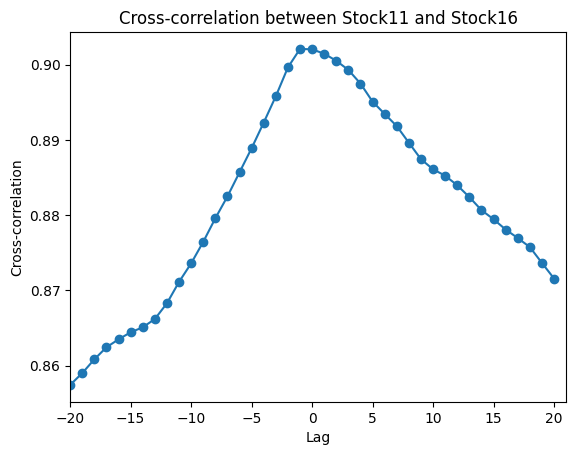

[0.8951306854672488, 0.8961986100916111, 0.8975681148044045, 0.8992204177923062, 0.9011662226927128, 0.9030297005035012, 0.9055180720244836, 0.9076286611786, 0.9092131474537862, 0.9105221511509167, 0.9115837834865799, 0.9129389510876421, 0.9140601889790656, 0.914179679678418, 0.9140967552045127, 0.9135902990439061, 0.9131239714638342, 0.9127140602054126, 0.9127496305394334, 0.9128142061961899, 0.9128328972067835, 0.9123447798909159, 0.9116279074444668, 0.9107717984616965, 0.9104263021089568, 0.9098066614278323, 0.9091698176844495, 0.9084131587707399, 0.9081452747520266, 0.9078364922821784, 0.9075456143932789, 0.9070871783332252, 0.9064117297632118, 0.9052726933061754, 0.9038059628105369, 0.9017033790902818, 0.8999036733027682, 0.8984008709899951, 0.8972398365979616, 0.8965277020077782, 0.8961299309307724]


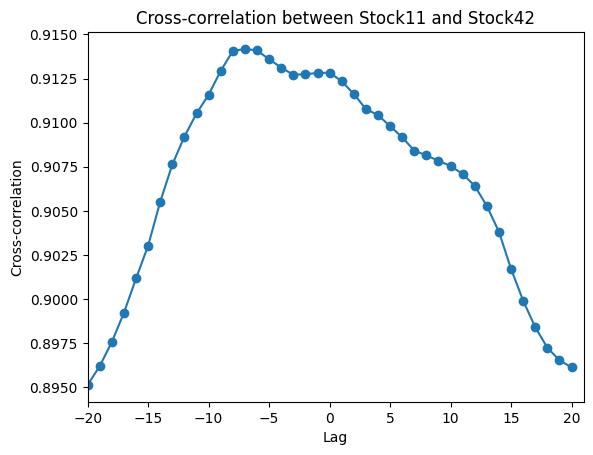

[0.9148204838980183, 0.9146167027878647, 0.9144384601924955, 0.91429121196645, 0.9141009767073873, 0.9139913259646577, 0.9137848299887432, 0.9135939780322735, 0.9132929807069747, 0.9129143617630169, 0.9126515868654783, 0.9124963753301556, 0.912392109557002, 0.9125661600127396, 0.9128469769490524, 0.9133475161397643, 0.9139142718524341, 0.9145290356104693, 0.9153726046397647, 0.9162120374074324, 0.9170565052444545, 0.9171114987756751, 0.9167867656704087, 0.9164560620755309, 0.9162835805882474, 0.9161060574201575, 0.9158941389189484, 0.9156393513709358, 0.9153223042165832, 0.9148315097074383, 0.91426225867396, 0.913801217704643, 0.9134749685145803, 0.9130436906245294, 0.9127521284422209, 0.9125974408771621, 0.912680599105414, 0.9126072380320625, 0.9127072083629, 0.9129029521190903, 0.9131011857578072]


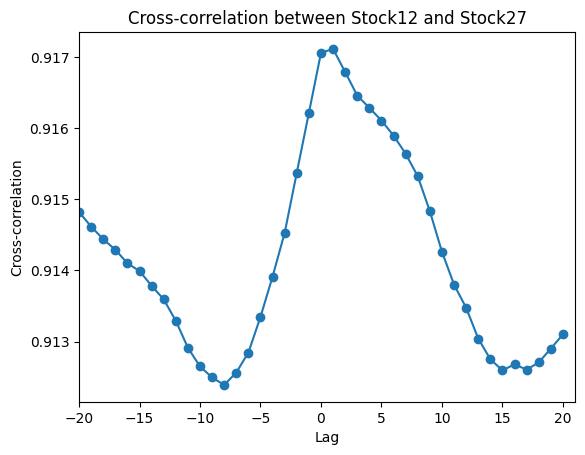

[0.8074189820150633, 0.8070352483089889, 0.8061043910398527, 0.8054791040562684, 0.8052846381736912, 0.8057275308182542, 0.8063553311921979, 0.8072583925820576, 0.8083287428886001, 0.8097784655615345, 0.811770181902589, 0.8137714992715922, 0.8151933578330376, 0.8168047449396915, 0.8182339816868854, 0.8195729483556862, 0.821667821670963, 0.8238671802013383, 0.8263060750768615, 0.8290253760726974, 0.831501922502974, 0.8333951582281338, 0.8351301407458557, 0.8368985146185376, 0.8390550738879438, 0.8424767687718027, 0.8460231730881639, 0.8502213088053994, 0.8544371424691422, 0.858538248927163, 0.8629175177689257, 0.8664858942743953, 0.8710851170020092, 0.8754944394913352, 0.8794785638479586, 0.8826012741905502, 0.8861804819105759, 0.889186053290693, 0.8928470225734833, 0.8974817840606196, 0.9010745785058994]


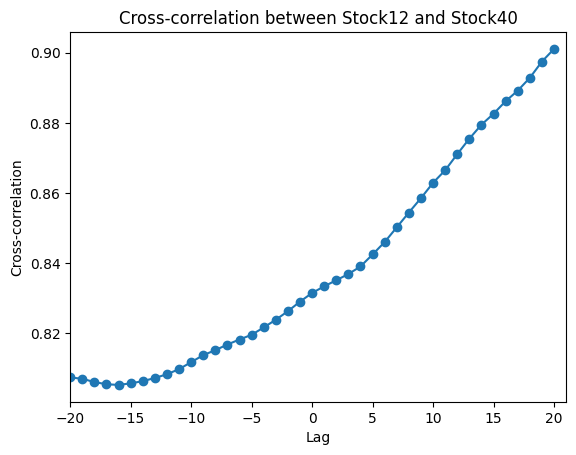

[0.9169023885230302, 0.9174805217662726, 0.9179327732374694, 0.9185732713985518, 0.9192493971847282, 0.9198873489454283, 0.9204165082261382, 0.920695086313377, 0.9206438032018571, 0.9204096294980729, 0.9201218861490416, 0.9197162406543721, 0.9189614176459153, 0.9181527163252059, 0.9174050134395834, 0.916692267957636, 0.9158845932753887, 0.9148691560436795, 0.9134934088141632, 0.9117572121956955, 0.9097625082197384, 0.9074716238857724, 0.9048482225097634, 0.9021757761749224, 0.8994734454050328, 0.8969168292761039, 0.8944158386009331, 0.8922927776435476, 0.8903494062220282, 0.8884927332032285, 0.8868914997854143, 0.8851980783505874, 0.8837499458386635, 0.8820507334835489, 0.8803689292572924, 0.8787479061430121, 0.8769215519929631, 0.8749683304695477, 0.8729106334341669, 0.87073581413514, 0.8685544212369711]


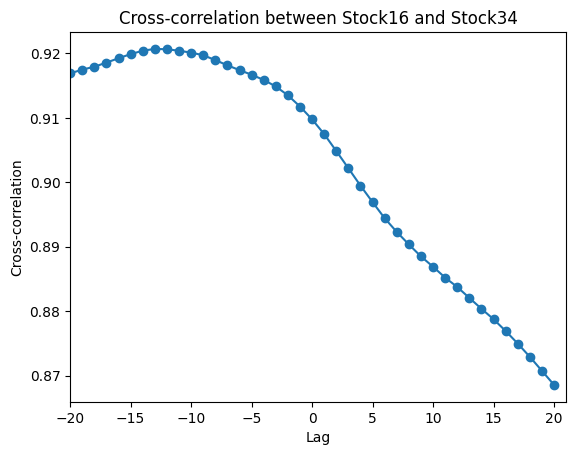

[0.9137993498553288, 0.912662499329936, 0.9114834435113365, 0.9101033044477814, 0.9088001181196677, 0.9075524477550695, 0.9062472319605136, 0.9051366399049934, 0.9041396809019486, 0.9031639208798847, 0.9021305160995804, 0.9011898164333024, 0.9004536836182654, 0.8998728381488078, 0.8993011413592104, 0.898827949223639, 0.8983227821999692, 0.8978629769032468, 0.8975225128212239, 0.8971400020185747, 0.896723828622038, 0.8960737406849713, 0.8953701094782566, 0.8946546179146622, 0.8939229245678819, 0.8932220304380782, 0.8925131152584316, 0.891638066231779, 0.8906056506080162, 0.8895030907439967, 0.8884406177200098, 0.887470468382154, 0.8864695725048711, 0.8856126959127573, 0.8848036368382, 0.8839506744284236, 0.8832773236252512, 0.8828167554298219, 0.8823676964179072, 0.8819173102988068, 0.8815734875746434]


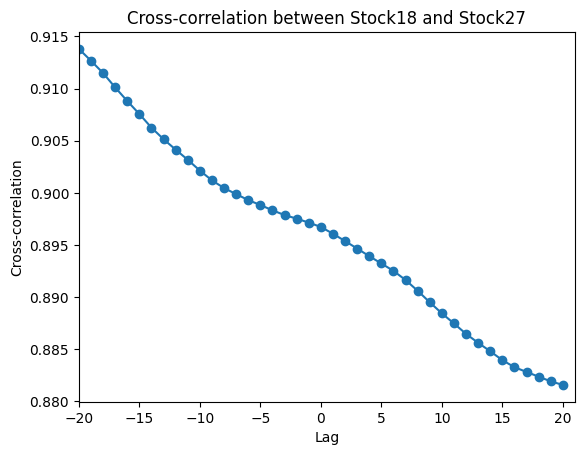

[0.9163674291471076, 0.9155046508957599, 0.9145576690389146, 0.9137629811489146, 0.9131739831173492, 0.9124044928913188, 0.9118159174028447, 0.9116552916375202, 0.9112622595651191, 0.9109293124445742, 0.9109278900659212, 0.9112205128763874, 0.9115115659570425, 0.9119774199902665, 0.9124113325559632, 0.9126974104898314, 0.9129873662312156, 0.9136214014273277, 0.9136906144682988, 0.9137694388227136, 0.9137460520012064, 0.9132932922827461, 0.912923488738273, 0.9127688519466061, 0.9125403831261102, 0.9117982859823035, 0.9114329419542726, 0.911066266422297, 0.9108908027927544, 0.9103100693199694, 0.9094052061907544, 0.9083433940040292, 0.907192761675181, 0.906007356274328, 0.9051062954608527, 0.9038688969742588, 0.9025943412451215, 0.9015114301580651, 0.9004255488154842, 0.8995074048936937, 0.8985385747463493]


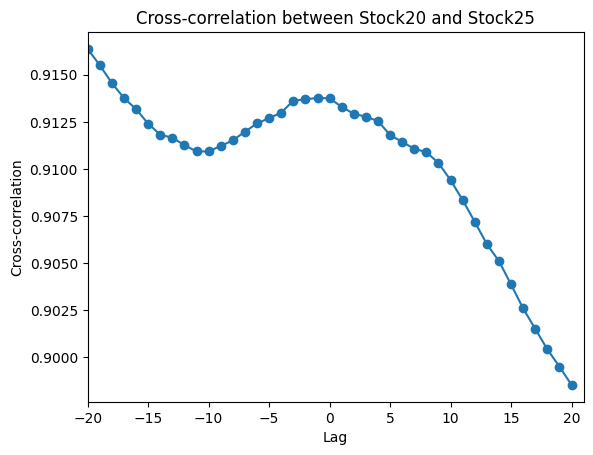

[0.8799772981484416, 0.8812404217191162, 0.882794689816114, 0.8843023868304576, 0.8859202009557182, 0.8875453985311921, 0.8891531987037937, 0.8908301067808382, 0.8928453567383603, 0.8942961423753203, 0.8958274682525457, 0.897198419891904, 0.8982227036109222, 0.8994140295478986, 0.9006148221994051, 0.9018621711404214, 0.9029068276897024, 0.9039555044133611, 0.9054563416195955, 0.9071326762897235, 0.9085965658619374, 0.9099587396660984, 0.9114539159243992, 0.9126343586278882, 0.9136793031850085, 0.9149190643796439, 0.9160425780417578, 0.9166704439726362, 0.9169075077035312, 0.9169316311372531, 0.9169987956651953, 0.9167217939772264, 0.916433317807922, 0.9158861491093929, 0.9154575017561175, 0.9149491785483198, 0.9142832798349559, 0.9139798599270542, 0.9137496886913296, 0.913577648410232, 0.9137237593423553]


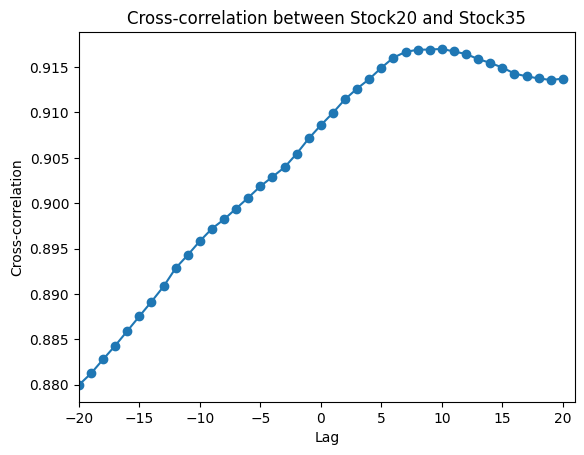

[0.9181626703972215, 0.9183608842608618, 0.9184624632510727, 0.9183273179096735, 0.9180578877549089, 0.9176027914702197, 0.9173114122755643, 0.917247840168278, 0.9173301273192612, 0.9173188322365247, 0.9171936324135894, 0.9171236613123797, 0.9168493726761948, 0.9168624115500599, 0.9171566251621366, 0.9171951435939623, 0.9171631035823371, 0.9169560082194743, 0.9168242131388272, 0.916694923384171, 0.9167475960699991, 0.9169119086396221, 0.9171500411426906, 0.9174429114190426, 0.9174921155642614, 0.9178170973950475, 0.9180267215454336, 0.9181972150055061, 0.9184471610864012, 0.9190662166455272, 0.919953730680833, 0.9206791129131067, 0.9212076647050279, 0.921385784296655, 0.9217376686107563, 0.9219512281150473, 0.922530494519708, 0.9230361756793545, 0.9235090203181162, 0.9238210610357374, 0.9241012783292231]


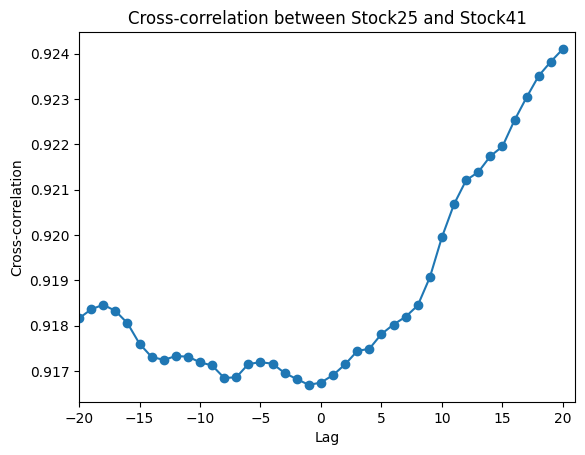

[0.9404889229413341, 0.9398585799064446, 0.9387873947285362, 0.9373979620750558, 0.9360915772064601, 0.9345591623958629, 0.9332508677778032, 0.9321068861593645, 0.930837501878472, 0.9295731191805162, 0.9284265171171789, 0.9275278195762726, 0.926440065816625, 0.9252833488390056, 0.9244315136988476, 0.9235633595549337, 0.9227023041505433, 0.9220047224229332, 0.920949883773735, 0.9195741494969094, 0.9183733246500079, 0.917283942287948, 0.9161178228446848, 0.9151741551869075, 0.9141894103264027, 0.9129099855344348, 0.9112473829926103, 0.909252412219674, 0.9074295913746024, 0.9053629056304318, 0.9033027305197642, 0.9012326804409815, 0.8993714651615966, 0.8977307903577676, 0.895959516834286, 0.893918209785477, 0.8924629231651956, 0.8910001435736383, 0.8898183364427504, 0.8885170392609054, 0.8870987172529662]


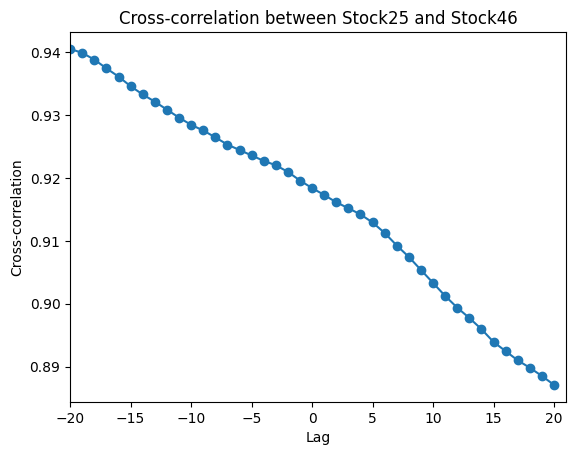

[0.9249248587889729, 0.9246179441145397, 0.9243777806198397, 0.9242226266624184, 0.9240532611433491, 0.9239219901428221, 0.9237692877037398, 0.9235939957492227, 0.9233757760700465, 0.9231241306690088, 0.9227983246736019, 0.922473343045935, 0.9221021932978536, 0.9216751596110161, 0.921080092062986, 0.9204076391346853, 0.9194935438891486, 0.9185119305877995, 0.9173677301244199, 0.9160948534555029, 0.9146437779431412, 0.913067297051625, 0.9113346748551316, 0.9095247825060315, 0.9076715920754296, 0.9059848624953041, 0.9042909934106256, 0.9027029705342751, 0.9011359635537154, 0.8995473749767996, 0.897981408920058, 0.8964197045905825, 0.8949855908116154, 0.8935341247795267, 0.8921340719473599, 0.8908657224818795, 0.8896335140469676, 0.8883866098497123, 0.8871499128728229, 0.8857906237844919, 0.8844548823658154]


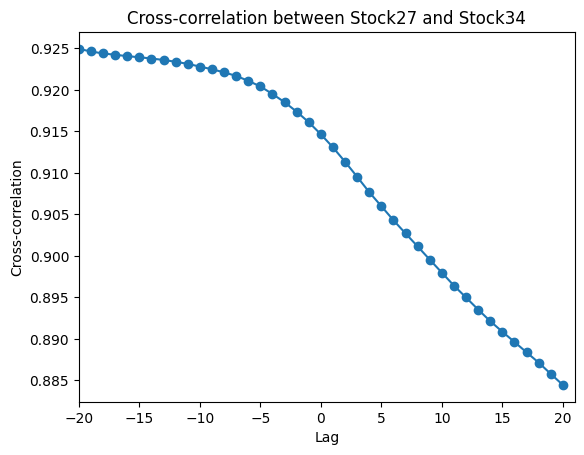

[0.9604354026788224, 0.9600100708025856, 0.9596085418354455, 0.9593545545551984, 0.9590513187662106, 0.9588841487493319, 0.9587339273388706, 0.958611443789565, 0.9583836544169825, 0.9580047597638887, 0.9575870854625993, 0.9568581363030683, 0.9560566975596441, 0.9551882915466333, 0.9543220896272722, 0.9532124821443282, 0.9520027214104959, 0.950631480399497, 0.9493307279626789, 0.9480869392243475, 0.9467690103685872, 0.9453130624691118, 0.9438990101344525, 0.9424958678168553, 0.9410679090680779, 0.9397856190626304, 0.9385799644020945, 0.937257839578314, 0.9360899339279318, 0.9351044627496848, 0.9341074848330476, 0.9333215111047342, 0.9326654402839221, 0.9317901540458035, 0.930893959211264, 0.9299287391274794, 0.9288677513691499, 0.9279753989108648, 0.9272619338992397, 0.926784669570332, 0.9264918729271224]


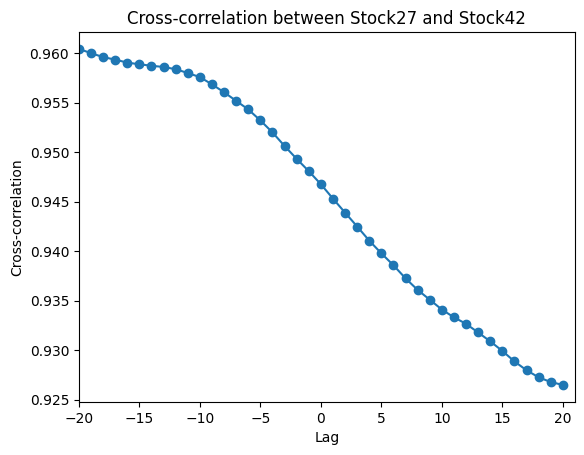

[0.9216206060906426, 0.9223568131100861, 0.9229513302845195, 0.9237447228604203, 0.9246264004134973, 0.9253575161584437, 0.9263121519498267, 0.92688320231144, 0.9272938732801466, 0.9278032911027086, 0.9285037551475777, 0.9291192639238468, 0.9298033002985457, 0.9302272918811425, 0.9308089276882747, 0.9314351963536801, 0.9320198498865807, 0.9325594793483759, 0.933255324948666, 0.9338644919506202, 0.9343845824092821, 0.9350437604038083, 0.93557633427684, 0.9358544777830865, 0.9364255536257762, 0.9368867841912941, 0.9370999933624148, 0.9373487317437065, 0.9376612067832414, 0.9379907680137711, 0.9384335607617572, 0.9391792649305736, 0.9396493811266513, 0.9400352519893888, 0.9401461626212537, 0.940219118507318, 0.9401476191288145, 0.9400112850011286, 0.9399652878071585, 0.9401358632720437, 0.9406259445063602]


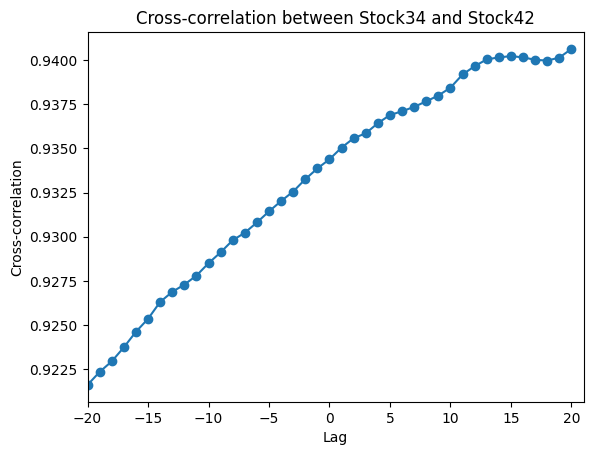

[0.897502291197565, 0.899451136428515, 0.9006865754765492, 0.9019391780494224, 0.9035243593296952, 0.9049129529362568, 0.9061399463929809, 0.9073898636076428, 0.9077142813375975, 0.9085543082439528, 0.910128774397358, 0.9117388299830536, 0.9131285866651195, 0.9139733158131136, 0.9143419553143635, 0.9143975560994477, 0.9145659306530992, 0.9147970329594104, 0.9147229148977716, 0.9144827271008443, 0.9133651521192566, 0.9122207350326966, 0.9110112691750688, 0.9099201845351551, 0.9079678984958046, 0.9062182130536187, 0.9045890155812641, 0.9032705097029075, 0.9021782674089803, 0.9016460938214191, 0.9009697409102246, 0.9004668284761963, 0.8999062888543122, 0.8991966788645361, 0.8989988875760353, 0.8983906779106025, 0.8973224650041313, 0.8960029136453466, 0.894350593507424, 0.8930780479080086, 0.891873682231986]


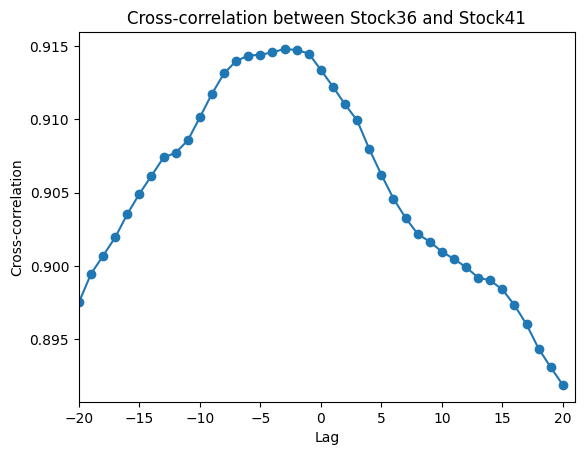

In [179]:
negative_lag = range(-20, 0)
positive_lag= range(0, 21)
correlated_pairs = {}
for (stock1, stock2) in list(itertools.combinations(range(0,50),2)):
    return_1 = price_df.loc[price_df['STOCK'] == stock1, "PRICE"].reset_index(drop=True)
    return_2 = price_df.loc[price_df['STOCK'] == stock2, "PRICE"].reset_index(drop=True)
    cross_corr_negative = [np.corrcoef(return_1, return_2.shift(lag).fillna(method="ffill"))[0,1] for lag in negative_lag]
    cross_corr_positive = [np.corrcoef(return_1, return_2.shift(lag).fillna(method="bfill"))[0,1] for lag in positive_lag]
    cross_corr = cross_corr_negative + cross_corr_positive
    if any([corr > 0.9 for corr in cross_corr]):
        print(cross_corr)
        # if any(not np.isnan(corr) for corr in cross_corr):
        #     correlated_pairs.append((stock1, stock2))
        plt.plot(range(-20,21), cross_corr, marker="o")
        plt.xlabel('Lag')
        plt.ylabel('Cross-correlation')
        plt.title(f'Cross-correlation between Stock{stock1} and Stock{stock2}')
        plt.xlim((-20, 21))
        plt.show()